In [1]:
try:
    import music21
except:
    !pip install music21
    !sudo apt-get update
    !sudo apt install musescore3 -y

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.8/22.8 MB 66.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 12.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.8/41.8 kB 2.9 MB/s eta 0:00:00
Get:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease [1581 B]
Get:2 https://packages.cloud.google.com/apt gcsfuse-focal InRelease [1225 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  Packages [1556 kB]
Get:4 https://packages.cloud.google.com/apt cloud-sdk InRelease [1616 B]
Hit:5 http://archive.ubuntu.com/ubuntu focal InRelease
Get:6 https://packages.cloud.google.com/apt google-fast-socket InRelease [1071 B]
Get:7 http://archive.ubuntu.com/ubuntu focal-updates InRelease [128 kB]
Get:8 http://security.ubuntu.com/ubuntu focal-security InRelease [128 kB]
Get:9 https://packages.cloud.google.com/apt gcsfuse-focal/main amd64 Packages [24.1 kB]
Get:10 https://packages.cloud.google.co

In [2]:
try:
    import midi2audio
except:
    !pip install midi2audio
    !sudo apt-get update
    !sudo apt-get install fluidsynth -y

Hit:1 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2004/x86_64  InRelease
Hit:2 https://packages.cloud.google.com/apt gcsfuse-focal InRelease
Hit:3 https://packages.cloud.google.com/apt cloud-sdk InRelease
Hit:4 http://archive.ubuntu.com/ubuntu focal InRelease
Hit:5 http://security.ubuntu.com/ubuntu focal-security InRelease
Hit:6 https://packages.cloud.google.com/apt google-fast-socket InRelease
Hit:7 http://archive.ubuntu.com/ubuntu focal-updates InRelease
Hit:8 http://archive.ubuntu.com/ubuntu focal-backports InRelease




The following additional packages will be installed:
  fluid-soundfont-gm libfluidsynth2 libinstpatch-1.0-2 qsynth
Suggested packages:
  fluid-soundfont-gs timidity jackd
The following NEW packages will be installed:
  fluid-soundfont-gm fluidsynth libfluidsynth2 libinstpatch-1.0-2 qsynth
0 upgraded, 5 newly installed, 0 to remove and 89 not upgraded.
Need to get 120 MB of archives.
After this operation, 151 MB of additional disk space will be use

In [3]:
!pip install np_utils


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - done
  Created wheel for np_utils: filename=np_utils-0.6.0-py3-none-any.whl size=56439 sha256=19657edf7c1b5decd9801b5988575c7317cc3c5811c7959575d22bf82b1ddb13
  Stored in directory: /root/.cache/pip/wheels/b6/c7/50/2307607f44366dd021209f660045f8d51cb976514d30be7cc7
Successfully built np_utils


In [4]:
import IPython
from IPython.display import Image, Audio
from midi2audio import FluidSynth
from music21 import corpus, converter, instrument, note, stream, chord, duration
import matplotlib.pyplot as plt
import time
import tensorflow as tf

import os
import pickle
import keras
from keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import plot_model

import os
import numpy as np
import glob

from keras.layers import LSTM, Input, Dropout, Dense, Activation, Embedding, Concatenate, Reshape
from keras.layers import Flatten, RepeatVector, Permute, TimeDistributed
from keras.layers import Multiply, Lambda, Softmax
import keras.backend as K 
from keras.models import Model
from tensorflow.keras.optimizers import RMSprop
from keras.utils import to_categorical


import np_utils
import seaborn as sns


2024-07-10 16:21:29.491228: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-10 16:21:29.491375: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-10 16:21:29.626164: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [5]:


print("Keras version:", keras.__version__)
print("TensorFlow version:", tf.__version__)


Keras version: 3.3.3
TensorFlow version: 2.15.0


In [6]:
dataset_name = '../input/classical-music-midi/chopin'
filename = 'chpn-p7'
file = "{}/{}.mid".format(dataset_name, filename)

original_score = converter.parse(file).chordify()

/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 1997 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


In [7]:
fs = FluidSynth()
file = '..//input/classical-music-midi/chopin/chpn-p7.mid'
fs.midi_to_audio(file, 'chpn-p7.wav')
IPython.display.Audio("chpn-p7.wav") 

Parameter '/root/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.


FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'chpn-p7.wav'..


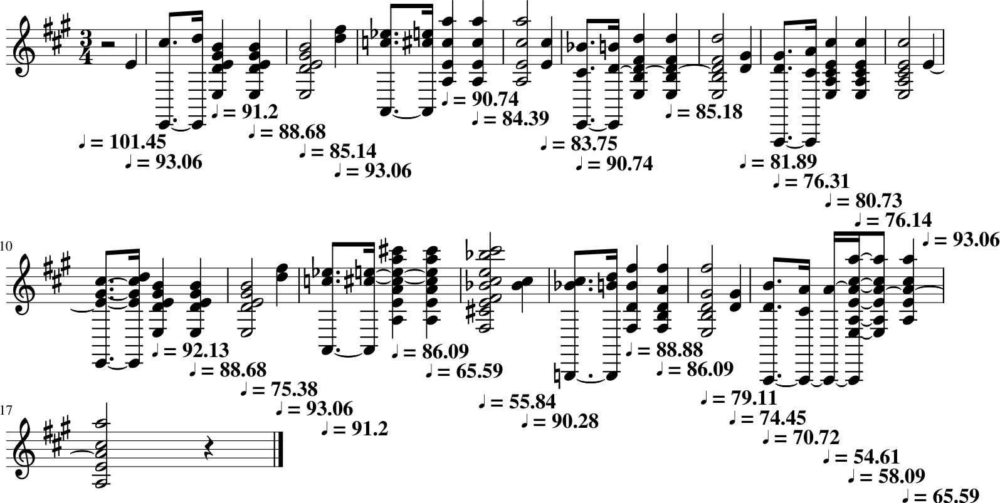

In [8]:
original_score.show()

---------------------
# Extracting the data

It loops through the score and extracts the pitch and time of each note (and rest) into two lists. The entire chord is stored as a string, and individual notes in the chord are separated by dots. The male after the name of each note refers to the octave to which the note belongs.

In [9]:
notes = []
durations = []

for element in original_score.flat:    
    if isinstance(element, chord.Chord):
        notes.append('.'.join(n.nameWithOctave for n in element.pitches))
        durations.append(element.duration.quarterLength)

    if isinstance(element, note.Note):
        if element.isRest:
            notes.append(str(element.name))
            durations.append(element.duration.quarterLength)
        else:
            notes.append(str(element.nameWithOctave))
            durations.append(element.duration.quarterLength)   

/opt/conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3553: Music21DeprecationWarning: .flat is deprecated.  Call .flatten() instead
  exec(code_obj, self.user_global_ns, self.user_ns)


In [10]:
print('\nduration', 'pitch')
idx = 0
for n,d in zip(notes,durations):
    if idx < 50:
        print(d, '\t', n)
    idx = idx + 1   


duration pitch
1.0 	 E4
0.75 	 E2.C#5
0.25 	 E2.D5
1.0 	 E3.D4.E4.G#4.B4
1.0 	 E3.D4.E4.G#4.B4
2.0 	 E3.D4.E4.G#4.B4
1.0 	 D5.F#5
0.75 	 A2.C5.E-5
0.25 	 A2.C#5.E5
1.0 	 A3.E4.C#5.A5
1.0 	 A3.E4.C#5.A5
2.0 	 A3.E4.C#5.A5
1.0 	 E4.C#5
0.75 	 E2.C#4.B-4
0.25 	 E2.D4.B4
1.0 	 E3.B3.D4.F#4.D5
1.0 	 E3.B3.D4.F#4.D5
2.0 	 E3.B3.D4.F#4.D5
1.0 	 D4.G#4
0.75 	 A1.D4.G#4
0.25 	 A1.C#4.A4
1.0 	 E3.A3.C#4.E4.C#5
1.0 	 E3.A3.C#4.E4.C#5
2.0 	 E3.A3.C#4.E4.C#5
1.0 	 E4
0.75 	 E2.E4.G#4.C#5
0.25 	 E2.E4.G#4.C#5.D5
1.0 	 E3.D4.E4.G#4.B4
1.0 	 E3.D4.E4.G#4.B4
2.0 	 E3.D4.E4.G#4.B4
1.0 	 D5.F#5
0.75 	 A2.C5.E-5
0.25 	 A2.C#5.E5
1.0 	 A3.E4.A4.C#5.E5.A5.C#6
1.0 	 A3.E4.A4.C#5.E5.A5.C#6
2.0 	 F#3.C#4.E4.F#4.B-4.C#5.E5.B-5.C#6
1.0 	 B-4.C#5
0.75 	 B1.B-4.C#5
0.25 	 B1.B4.D5
1.0 	 F#3.D4.B4.F#5
1.0 	 F#3.B3.D4.A4.F#5
2.0 	 E3.B3.D4.G#4.F#5
1.0 	 D4.G#4
0.75 	 A1.D4.B4
0.25 	 A1.C#4.A4
0.25 	 A1.A4
0.25 	 A1.E3.A3.E4.A4.C#5.A5
0.5 	 E3.A3.E4.A4.C#5.A5
1.0 	 A3.E4.A4.C#5.A5
2.0 	 A3.E4.A4.C#5.A5


In [11]:
print(notes[:50])

['E4', 'E2.C#5', 'E2.D5', 'E3.D4.E4.G#4.B4', 'E3.D4.E4.G#4.B4', 'E3.D4.E4.G#4.B4', 'D5.F#5', 'A2.C5.E-5', 'A2.C#5.E5', 'A3.E4.C#5.A5', 'A3.E4.C#5.A5', 'A3.E4.C#5.A5', 'E4.C#5', 'E2.C#4.B-4', 'E2.D4.B4', 'E3.B3.D4.F#4.D5', 'E3.B3.D4.F#4.D5', 'E3.B3.D4.F#4.D5', 'D4.G#4', 'A1.D4.G#4', 'A1.C#4.A4', 'E3.A3.C#4.E4.C#5', 'E3.A3.C#4.E4.C#5', 'E3.A3.C#4.E4.C#5', 'E4', 'E2.E4.G#4.C#5', 'E2.E4.G#4.C#5.D5', 'E3.D4.E4.G#4.B4', 'E3.D4.E4.G#4.B4', 'E3.D4.E4.G#4.B4', 'D5.F#5', 'A2.C5.E-5', 'A2.C#5.E5', 'A3.E4.A4.C#5.E5.A5.C#6', 'A3.E4.A4.C#5.E5.A5.C#6', 'F#3.C#4.E4.F#4.B-4.C#5.E5.B-5.C#6', 'B-4.C#5', 'B1.B-4.C#5', 'B1.B4.D5', 'F#3.D4.B4.F#5', 'F#3.B3.D4.A4.F#5', 'E3.B3.D4.G#4.F#5', 'D4.G#4', 'A1.D4.B4', 'A1.C#4.A4', 'A1.A4', 'A1.E3.A3.E4.A4.C#5.A5', 'E3.A3.E4.A4.C#5.A5', 'A3.E4.A4.C#5.A5', 'A3.E4.A4.C#5.A5']


In [12]:
from collections import Counter
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline

In [13]:
print("Total notes in all the Chopin midis in the dataset:", len(notes))

Total notes in all the Chopin midis in the dataset: 50


In [14]:
count_num = Counter(notes)
print("Total unique notes in the Corpus:", len(count_num))

Total unique notes in the Corpus: 31


In [15]:
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
#Average recurrenc for a note in Corpus
def Average(lst):
    return sum(lst) / len(lst)
print("Average recurrenc for a note in Corpus:", Average(Recurrence))
print("Most frequent note in Corpus appeared:", max(Recurrence), "times")
print("Least frequent note in Corpus appeared:", min(Recurrence), "time")

Average recurrenc for a note in Corpus: 1.6129032258064515
Most frequent note in Corpus appeared: 6 times
Least frequent note in Corpus appeared: 1 time


## Defiing Helper Functions

In [16]:
def get_music_list(data_folder):    
    file_list = glob.glob(os.path.join(data_folder, "*.mid"))
    parser = converter    
    return file_list, parser

def create_network(n_notes, n_durations, embed_size=100, rnn_units=256, use_attention=False):
    notes_in = Input(shape=(None,))
    durations_in = Input(shape=(None,))

    x1 = Embedding(n_notes, embed_size)(notes_in)
    x2 = Embedding(n_durations, embed_size)(durations_in)
    x = Concatenate()([x1, x2])
    x = LSTM(rnn_units, return_sequences=True)(x)

    if use_attention:
        x = LSTM(rnn_units, return_sequences=True)(x)
        e = Dense(1, activation='tanh')(x)
        e = Reshape([-1])(e)
        alpha = Activation('softmax')(e)
        alpha_repeated = Permute([2, 1])(RepeatVector(rnn_units)(alpha))
        c = Multiply()([x, alpha_repeated])
        c = Lambda(lambda xin: tf.keras.backend.sum(xin, axis=1), output_shape=(rnn_units,))(c)
    else:
        c = LSTM(rnn_units)(x)

    notes_out = Dense(n_notes, activation='softmax', name='pitch')(c)
    durations_out = Dense(n_durations, activation='softmax', name='duration')(c)

    model = Model([notes_in, durations_in], [notes_out, durations_out])

    if use_attention:
        att_model = Model([notes_in, durations_in], alpha)
    else:
        att_model = None

    opti = RMSprop(learning_rate=0.001)
    model.compile(loss=['categorical_crossentropy', 'categorical_crossentropy'], optimizer=opti, metrics=['accuracy','accuracy']
 )

    return model, att_model


def get_distinct(elements):
    # Get all pitch names
    element_names = sorted(set(elements))
    n_elements = len(element_names)
    return (element_names, n_elements)

def create_lookups(element_names):
    # create dictionary to map notes and durations to integers
    element_to_int = dict((element, number) for number, element in enumerate(element_names))
    int_to_element = dict((number, element) for number, element in enumerate(element_names))
    return (element_to_int, int_to_element)    

def prepare_sequences(notes, durations, lookups, distincts, seq_len =32):
    note_to_int, int_to_note, duration_to_int, int_to_duration = lookups
    note_names, n_notes, duration_names, n_durations = distincts

    notes_network_input = []
    notes_network_output = []
    durations_network_input = []
    durations_network_output = []

    # create input sequences and the corresponding outputs
    for i in range(len(notes) - seq_len):
        notes_sequence_in = notes[i:i + seq_len]
        notes_sequence_out = notes[i + seq_len]
        notes_network_input.append([note_to_int[char] for char in notes_sequence_in])
        notes_network_output.append(note_to_int[notes_sequence_out])

        durations_sequence_in = durations[i:i + seq_len]
        durations_sequence_out = durations[i + seq_len]
        durations_network_input.append([duration_to_int[char] for char in durations_sequence_in])
        durations_network_output.append(duration_to_int[durations_sequence_out])

    n_patterns = len(notes_network_input)

    # reshape the input into a format compatible with LSTM layers
    notes_network_input = np.reshape(notes_network_input, (n_patterns, seq_len))
    durations_network_input = np.reshape(durations_network_input, (n_patterns, seq_len))
    network_input = [notes_network_input, durations_network_input]

    notes_network_output = to_categorical(notes_network_output, num_classes=n_notes)
    durations_network_output = to_categorical(durations_network_output, num_classes=n_durations)
    network_output = [notes_network_output, durations_network_output]
    return (network_input, network_output)

def sample_with_temp(preds, temperature):
    if temperature == 0:
        return np.argmax(preds)
    else:
        preds = np.log(preds) / temperature
        exp_preds = np.exp(preds)
        preds = exp_preds / np.sum(exp_preds)
        return np.random.choice(len(preds), p=preds)

In [17]:
# run params
run_folder = '/kaggle/working'

store_folder = os.path.join(run_folder, 'store')
data_folder ='..//input/classical-music-midi/chopin'

if not os.path.exists('store'):
    os.mkdir(os.path.join(run_folder, 'store'))
    os.mkdir(os.path.join(run_folder, 'output'))
    os.mkdir(os.path.join(run_folder, 'weights'))
    os.mkdir(os.path.join(run_folder, 'viz'))

mode = 'build'

# data params
intervals = range(1)
seq_len = 64

# model params
embed_size = 100
rnn_units = 256
use_attention = True

In [18]:
if mode == 'build':    
    music_list, parser = get_music_list(data_folder)
    print(len(music_list), 'files in total')

    notes = []
    durations = []

    for i, file in enumerate(music_list):
        print(i+1, "Parsing %s" % file)
        print(file)
        original_score = parser.parse(file).chordify()        
        for interval in intervals:
            score = original_score.transpose(interval)

            notes.extend(['START'] * seq_len)
            durations.extend([0]* seq_len)

            for element in score.flat:                
                if isinstance(element, note.Note):
                    if element.isRest:
                        notes.append(str(element.name))
                        durations.append(element.duration.quarterLength)
                    else:
                        notes.append(str(element.nameWithOctave))
                        durations.append(element.duration.quarterLength)
                        
                if isinstance(element, chord.Chord):
                    notes.append('.'.join(n.nameWithOctave for n in element.pitches))
                    durations.append(element.duration.quarterLength)

    with open(os.path.join(store_folder, 'notes'), 'wb') as f:
        pickle.dump(notes, f) 
    with open(os.path.join(store_folder, 'durations'), 'wb') as f:
        pickle.dump(durations, f) 
else:
    with open(os.path.join(store_folder, 'notes'), 'rb') as f:
        notes = pickle.load(f)
    with open(os.path.join(store_folder, 'durations'), 'rb') as f:
        durations = pickle.load(f) 

48 files in total
1 Parsing ..//input/classical-music-midi/chopin/chpn-p13.mid
..//input/classical-music-midi/chopin/chpn-p13.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 2002 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


2 Parsing ..//input/classical-music-midi/chopin/chpn_op66.mid
..//input/classical-music-midi/chopin/chpn_op66.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 2003 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


3 Parsing ..//input/classical-music-midi/chopin/chpn_op35_1.mid
..//input/classical-music-midi/chopin/chpn_op35_1.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=5, channel=None, data=b'Copyright \xa9 2002 by Bernd Kr\xfcger'>; getting generic Instrument
  warnings.warn(


4 Parsing ..//input/classical-music-midi/chopin/chpn-p10.mid
..//input/classical-music-midi/chopin/chpn-p10.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 1997 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


5 Parsing ..//input/classical-music-midi/chopin/chpn_op23.mid
..//input/classical-music-midi/chopin/chpn_op23.mid
6 Parsing ..//input/classical-music-midi/chopin/chpn-p4.mid
..//input/classical-music-midi/chopin/chpn-p4.mid
7 Parsing ..//input/classical-music-midi/chopin/chpn-p2.mid
..//input/classical-music-midi/chopin/chpn-p2.mid
8 Parsing ..//input/classical-music-midi/chopin/chpn_op25_e2.mid
..//input/classical-music-midi/chopin/chpn_op25_e2.mid
9 Parsing ..//input/classical-music-midi/chopin/chpn_op35_2.mid
..//input/classical-music-midi/chopin/chpn_op35_2.mid
10 Parsing ..//input/classical-music-midi/chopin/chpn_op27_2.mid
..//input/classical-music-midi/chopin/chpn_op27_2.mid
11 Parsing ..//input/classical-music-midi/chopin/chpn-p7.mid
..//input/classical-music-midi/chopin/chpn-p7.mid
12 Parsing ..//input/classical-music-midi/chopin/chpn_op33_4.mid
..//input/classical-music-midi/chopin/chpn_op33_4.mid
13 Parsing ..//input/classical-music-midi/chopin/chpn-p1.mid
..//input/classica

/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=5, channel=None, data=b'Copyright \xa9 1997 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


15 Parsing ..//input/classical-music-midi/chopin/chpn-p17.mid
..//input/classical-music-midi/chopin/chpn-p17.mid
16 Parsing ..//input/classical-music-midi/chopin/chpn_op10_e05.mid
..//input/classical-music-midi/chopin/chpn_op10_e05.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=0, channel=None, data=b'Et\xfcde Opus 10 No. 5'>; getting generic Instrument
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=0, channel=None, data=b'Schwarze-Tasten-Et\xfcde'>; getting generic Instrument
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 1999 by Bernd Kr\xfcger'>; getting generic Instrument
  warnings.warn(


17 Parsing ..//input/classical-music-midi/chopin/chpn-p11.mid
..//input/classical-music-midi/chopin/chpn-p11.mid
18 Parsing ..//input/classical-music-midi/chopin/chpn_op27_1.mid
..//input/classical-music-midi/chopin/chpn_op27_1.mid
19 Parsing ..//input/classical-music-midi/chopin/chpn_op33_2.mid
..//input/classical-music-midi/chopin/chpn_op33_2.mid
20 Parsing ..//input/classical-music-midi/chopin/chpn-p18.mid
..//input/classical-music-midi/chopin/chpn-p18.mid
21 Parsing ..//input/classical-music-midi/chopin/chpn-p15.mid
..//input/classical-music-midi/chopin/chpn-p15.mid
22 Parsing ..//input/classical-music-midi/chopin/chpn_op25_e11.mid
..//input/classical-music-midi/chopin/chpn_op25_e11.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=0, channel=None, data=b'Et\xfcde Opus 25, No. 11'>; getting generic Instrument
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=0, channel=None, data=b'Sturmet\xfcde'>; getting generic Instrument
  warnings.warn(


23 Parsing ..//input/classical-music-midi/chopin/chpn-p6.mid
..//input/classical-music-midi/chopin/chpn-p6.mid
24 Parsing ..//input/classical-music-midi/chopin/chpn_op10_e01.mid
..//input/classical-music-midi/chopin/chpn_op10_e01.mid
25 Parsing ..//input/classical-music-midi/chopin/chpn_op25_e1.mid
..//input/classical-music-midi/chopin/chpn_op25_e1.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=5, channel=None, data=b'Copyright \xa9 2002 by Bernd Krueger'>; getting generic Instrument
  warnings.warn(


26 Parsing ..//input/classical-music-midi/chopin/chpn-p12.mid
..//input/classical-music-midi/chopin/chpn-p12.mid
27 Parsing ..//input/classical-music-midi/chopin/chpn-p20.mid
..//input/classical-music-midi/chopin/chpn-p20.mid
28 Parsing ..//input/classical-music-midi/chopin/chpn-p9.mid
..//input/classical-music-midi/chopin/chpn-p9.mid
29 Parsing ..//input/classical-music-midi/chopin/chpn-p14.mid
..//input/classical-music-midi/chopin/chpn-p14.mid
30 Parsing ..//input/classical-music-midi/chopin/chpn-p24.mid
..//input/classical-music-midi/chopin/chpn-p24.mid
31 Parsing ..//input/classical-music-midi/chopin/chpn-p5.mid
..//input/classical-music-midi/chopin/chpn-p5.mid
32 Parsing ..//input/classical-music-midi/chopin/chpn_op25_e12.mid
..//input/classical-music-midi/chopin/chpn_op25_e12.mid
33 Parsing ..//input/classical-music-midi/chopin/chpn_op25_e4.mid
..//input/classical-music-midi/chopin/chpn_op25_e4.mid
34 Parsing ..//input/classical-music-midi/chopin/chpn_op53.mid
..//input/classical

/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=0, channel=None, data=b'Et\xfcde Nr. 12'>; getting generic Instrument
  warnings.warn(


39 Parsing ..//input/classical-music-midi/chopin/chpn_op35_4.mid
..//input/classical-music-midi/chopin/chpn_op35_4.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 2002 by Bernd Kr\xfcger'>; getting generic Instrument
  warnings.warn(


40 Parsing ..//input/classical-music-midi/chopin/chpn-p19.mid
..//input/classical-music-midi/chopin/chpn-p19.mid
41 Parsing ..//input/classical-music-midi/chopin/chpn-p3.mid
..//input/classical-music-midi/chopin/chpn-p3.mid
42 Parsing ..//input/classical-music-midi/chopin/chpn_op7_1.mid
..//input/classical-music-midi/chopin/chpn_op7_1.mid
43 Parsing ..//input/classical-music-midi/chopin/chpn-p22.mid
..//input/classical-music-midi/chopin/chpn-p22.mid
44 Parsing ..//input/classical-music-midi/chopin/chpn_op35_3.mid
..//input/classical-music-midi/chopin/chpn_op35_3.mid
45 Parsing ..//input/classical-music-midi/chopin/chp_op31.mid
..//input/classical-music-midi/chopin/chp_op31.mid


/opt/conda/lib/python3.10/site-packages/music21/midi/translate.py:874: TranslateWarning: Unable to determine instrument from <music21.midi.MidiEvent SEQUENCE_TRACK_NAME, track=4, channel=None, data=b'Copyright \xa9 1997 by Bernd Kr\xfcger'>; getting generic Instrument
  warnings.warn(


46 Parsing ..//input/classical-music-midi/chopin/chp_op18.mid
..//input/classical-music-midi/chopin/chp_op18.mid
47 Parsing ..//input/classical-music-midi/chopin/chpn-p21.mid
..//input/classical-music-midi/chopin/chpn-p21.mid
48 Parsing ..//input/classical-music-midi/chopin/chpn_op7_2.mid
..//input/classical-music-midi/chopin/chpn_op7_2.mid


------------------------------------------
# Embedding Note and Duration

To create a dataset for training the model, we first convert the pitch and tempo into integer values. It doesn't matter what these values are because we use an embedding layer to convert the integer to a vector.

In [19]:
# get the distinct sets of notes and durations
note_names, n_notes = get_distinct(notes)
duration_names, n_durations = get_distinct(durations)
distincts = [note_names, n_notes, duration_names, n_durations]

with open(os.path.join(store_folder, 'distincts'), 'wb') as f:
    pickle.dump(distincts, f)

# make the lookup dictionaries for notes and dictionaries and save
note_to_int, int_to_note = create_lookups(note_names)
duration_to_int, int_to_duration = create_lookups(duration_names)
lookups = [note_to_int, int_to_note, duration_to_int, int_to_duration]

with open(os.path.join(store_folder, 'lookups'), 'wb') as f:
    pickle.dump(lookups, f)

In [20]:
print('\nnote_to_int')
for i, item in enumerate(note_to_int.items()):
    if i < 10:
        print(item)


note_to_int
('A1', 0)
('A1.A2', 1)
('A1.A2.A3', 2)
('A1.A2.A3.A4', 3)
('A1.A2.A3.C#4.A4', 4)
('A1.A2.A3.C#4.E4', 5)
('A1.A2.A3.D4', 6)
('A1.A2.A4', 7)
('A1.A2.A4.A5', 8)
('A1.A2.A4.C#5.A5', 9)


In [21]:
print('\nduration_to_int')
duration_to_int


duration_to_int


{0: 0,
 Fraction(1, 12): 1,
 Fraction(1, 6): 2,
 0.25: 3,
 Fraction(1, 3): 4,
 Fraction(5, 12): 5,
 0.5: 6,
 Fraction(7, 12): 7,
 Fraction(2, 3): 8,
 0.75: 9,
 1.0: 10,
 1.25: 11,
 Fraction(4, 3): 12,
 Fraction(17, 12): 13,
 1.5: 14,
 Fraction(5, 3): 15,
 1.75: 16,
 2.0: 17,
 2.5: 18,
 Fraction(8, 3): 19,
 2.75: 20,
 3.0: 21,
 3.25: 22,
 3.5: 23,
 4.0: 24,
 6.0: 25}

In [22]:
network_input, network_output = prepare_sequences(notes, durations, lookups, distincts, seq_len)

Divide the dataset by 32 notes to create the training set. Target is the next pitch and time signature in the sequence.

In [23]:
print('pitch input')
print(network_input[0][0])
print('duration input')
print(network_input[1][0])
print('pitch target')
print(network_output[0][0])
print('duration target')
print(network_output[1][0])

pitch input
[11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427
 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427
 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427
 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427
 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427 11427
 11427 11427 11427 11427]
duration input
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
pitch target
[0. 0. 0. ... 0. 0. 0.]
duration target
[0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0.]


----------------------------------
# Modeling

In [24]:
model, att_model = create_network(n_notes, n_durations, embed_size, rnn_units, use_attention)
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ input_layer_1       │ (None, None)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding           │ (None, None, 100) │  1,142,800 │ input_layer[0][0] │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_1         │ (None, None, 100) │      2,600 │ input_layer_1[0]… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concatenate         │ (None, None, 200) │          0 │ embedding[0][0],  │
│ (Concatenate)       │                   │            │ embedding_1[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm (LSTM)         │ (None, None, 256) │    467,968 │ concatenate[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_1 (LSTM)       │ (None, None, 256) │    525,312 │ lstm[0][0]        │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense (Dense)       │ (None, None, 1)   │        257 │ lstm_1[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape (Reshape)   │ (None, None)      │          0 │ dense[0][0]       │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, None)      │          0 │ reshape[0][0]     │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector       │ (None, 256, None) │          0 │ activation[0][0]  │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute (Permute)   │ (None, None, 256) │          0 │ repeat_vector[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply (Multiply) │ (None, None, 256) │          0 │ lstm_1[0][0],     │
│                     │                   │            │ permute[0][0]     │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 256)       │          0 │ multiply[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pitch (Dense)       │ (None, 11428)     │  2,936,996 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ duration (Dense)    │ (None, 26)        │      6,682 │ lambda[0][0]      │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 5,082,615 (19.39 MB)

 Trainable params: 5,082,615 (19.39 MB)

 Non-trainable params: 0 (0.00 B)

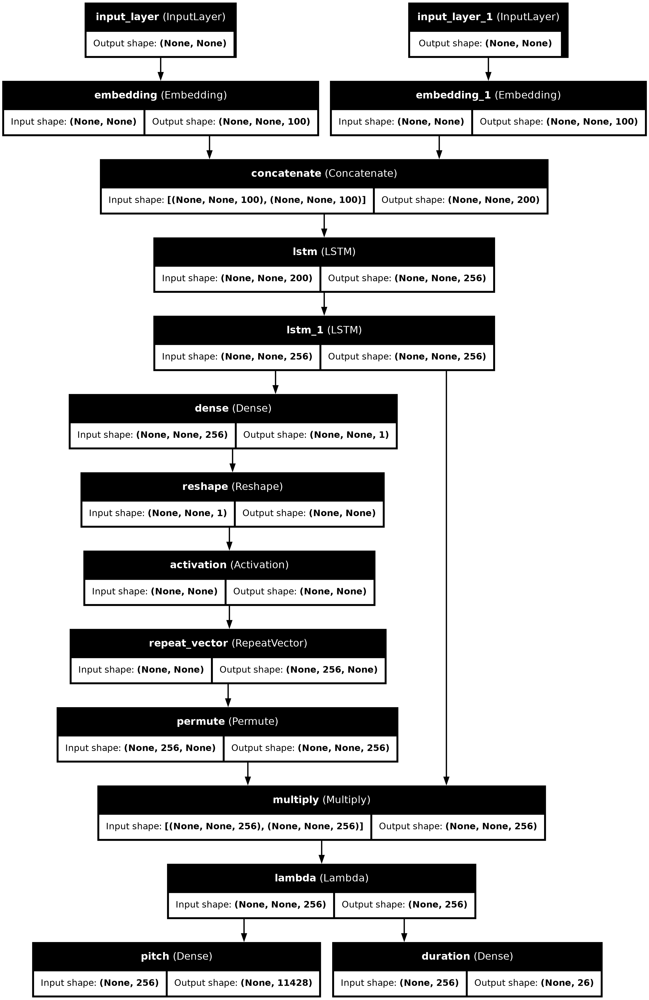

In [25]:
plot_model(model, to_file=os.path.join(run_folder ,'viz/model.png'), show_shapes = True, show_layer_names = True)

---------------------------------------------
# Training

In [26]:
import os
from keras.callbacks import ModelCheckpoint, EarlyStopping, Callback


weights_folder = os.path.join(run_folder, 'weights')

checkpoint1 = ModelCheckpoint(
    os.path.join(weights_folder, "weights-improvement-{epoch:02d}-{loss:.4f}-bigger.keras"),
    monitor='loss',
    verbose=0,
    save_best_only=True,
    mode='min'
)

checkpoint2 = ModelCheckpoint(
    os.path.join(weights_folder, "weights.keras"),
    monitor='loss',
    verbose=0,
    save_best_only=True,
    mode='min'
)

early_stopping = EarlyStopping(
    monitor='loss',
    restore_best_weights=True,
    patience=10
)


callbacks_list = [
    checkpoint1,
    checkpoint2,
    early_stopping]

# Ensure the weights file has the correct extension for saving weights
weights_file = os.path.join(weights_folder, "weights.weights.h5")
model.save_weights(weights_file)
model_json = model.to_json()
with open("/kaggle/working//model_architecture.json", "w") as json_file:
    json_file.write(model_json)

history = model.fit(
    network_input, network_output,
    epochs=150, batch_size=32,
    validation_split=0.2,
    callbacks=callbacks_list,
    shuffle=True
)



Epoch 1/150
1116/1116 ━━━━━━━━━━━━━━━━━━━━ 32s 24ms/step - duration_accuracy: 0.6709 - loss: 9.3929 - pitch_accuracy: 0.0726 - val_duration_accuracy: 0.6215 - val_loss: 9.6570 - val_pitch_accuracy: 0.0501
Epoch 2/150
1116/1116 ━━━━━━━━━━━━━━━━━━━━ 26s 23ms/step - duration_accuracy: 0.7769 - loss: 8.5340 - pitch_accuracy: 0.0780 - val_duration_accuracy: 0.6236 - val_loss: 9.6432 - val_pitch_accuracy: 0.0502
Epoch 3/150
1116/1116 ━━━━━━━━━━━━━━━━━━━━ 26s 23ms/step - duration_accuracy: 0.7954 - loss: 8.2041 - pitch_accuracy: 0.0871 - val_duration_accuracy: 0.6149 - val_loss: 9.6830 - val_pitch_accuracy: 0.0506
Epoch 4/150
1116/1116 ━━━━━━━━━━━━━━━━━━━━ 26s 23ms/step - duration_accuracy: 0.8002 - loss: 7.9480 - pitch_accuracy: 0.0939 - val_duration_accuracy: 0.5903 - val_loss: 9.8439 - val_pitch_accuracy: 0.0488
Epoch 5/150
1116/1116 ━━━━━━━━━━━━━━━━━━━━ 26s 23ms/step - duration_accuracy: 0.8018 - loss: 7.8047 - pitch_accuracy: 0.0960 - val_duration_accuracy: 0.5877 - val_loss: 9.7602 - va

In [27]:
print(history.history.keys())


dict_keys(['duration_accuracy', 'loss', 'pitch_accuracy', 'val_duration_accuracy', 'val_loss', 'val_pitch_accuracy'])


----------------------------------------
# Predicting

In [28]:
# prediction params
notes_temp=0.5
duration_temp = 0.5
max_extra_notes = 100
max_seq_len = 64
seq_len = 64

notes = ['START']
durations = [0]

if seq_len is not None:
    notes = ['START'] * (seq_len - len(notes)) + notes
    durations = [0] * (seq_len - len(durations)) + durations

sequence_length = len(notes)

In [29]:
prediction_output = []
notes_input_sequence = []
durations_input_sequence = []
overall_preds = []

for n, d in zip(notes,durations):
    note_int = note_to_int[n]
    duration_int = duration_to_int[d]
    
    notes_input_sequence.append(note_int)
    durations_input_sequence.append(duration_int)
    
    prediction_output.append([n, d])
    
    if n != 'START':
        midi_note = note.Note(n)
        new_note = np.zeros(256)
        new_note[midi_note.pitch.midi] = 1
        overall_preds.append(new_note)

att_matrix = np.zeros(shape = (max_extra_notes+sequence_length, max_extra_notes))

for note_index in range(max_extra_notes):

    prediction_input = [
        np.array([notes_input_sequence])
        , np.array([durations_input_sequence])
       ]

    notes_prediction, durations_prediction = model.predict(prediction_input, verbose=0)
    if use_attention:
        att_prediction = att_model.predict(prediction_input, verbose=0)[0]
        att_matrix[(note_index-len(att_prediction)+sequence_length):(note_index+sequence_length), note_index] = att_prediction
    
    new_note = np.zeros(256)
    
    for idx, n_i in enumerate(notes_prediction[0]):
        try:
            note_name = int_to_note[idx]
            midi_note = note.Note(note_name)
            new_note[midi_note.pitch.midi] = n_i            
        except:
            pass
        
    overall_preds.append(new_note)            
    
    i1 = sample_with_temp(notes_prediction[0], notes_temp)
    i2 = sample_with_temp(durations_prediction[0], duration_temp)    

    note_result = int_to_note[i1]
    duration_result = int_to_duration[i2]
    
    prediction_output.append([note_result, duration_result])

    notes_input_sequence.append(i1)
    durations_input_sequence.append(i2)
    
    if len(notes_input_sequence) > max_seq_len:
        notes_input_sequence = notes_input_sequence[1:]
        durations_input_sequence = durations_input_sequence[1:]
        
    if note_result == 'START':
        break

overall_preds = np.transpose(np.array(overall_preds)) 
print('Generated sequence of {} notes'.format(len(prediction_output)))

Generated sequence of 164 notes


---------------------------------------
# Intrepreting Model

-------------------------------------------
## Heatmap

Text(0.5, 1.0, 'Probability distribution of the next possible note over time')

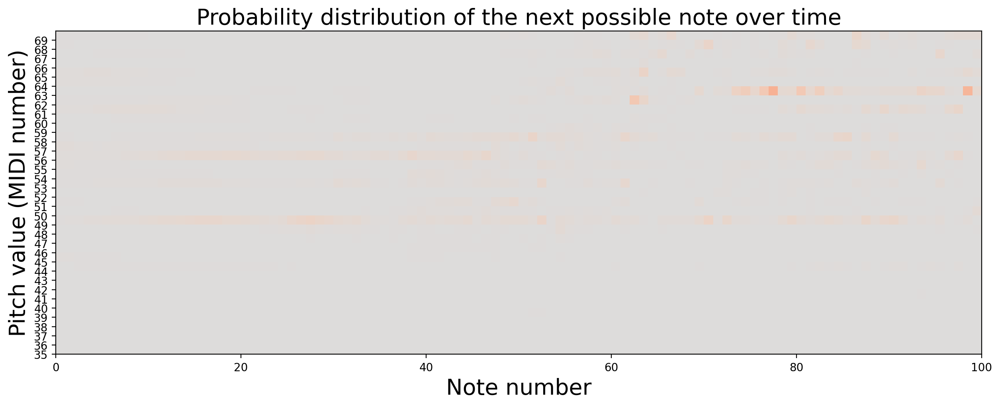

In [30]:
fig, ax = plt.subplots(figsize=(15,15))
ax.set_yticks([int(j) for j in range(35,70)])
plt.imshow(overall_preds[35:70,:], origin="lower", cmap='coolwarm', vmin = -0.5, vmax = 0.5, extent=[0, max_extra_notes, 35,70])
plt.xlabel("Note number",fontsize=20)
plt.ylabel("Pitch value (MIDI number)",fontsize=20)
plt.title("Probability distribution of the next possible note over time",fontsize=20)

In [31]:
output_folder = os.path.join(run_folder, 'output')

midi_stream = stream.Stream()

# create note and chord objects based on the values generated by the model
for pattern in prediction_output:
    note_pattern, duration_pattern = pattern
    # pattern is a chord
    if ('.' in note_pattern):
        notes_in_chord = note_pattern.split('.')
        chord_notes = []
        for current_note in notes_in_chord:
            new_note = note.Note(current_note)
            new_note.duration = duration.Duration(duration_pattern)
            new_note.storedInstrument = instrument.Violoncello()
            chord_notes.append(new_note)
        new_chord = chord.Chord(chord_notes)
        midi_stream.append(new_chord)
    elif note_pattern == 'rest':
    # pattern is a rest
        new_note = note.Rest()
        new_note.duration = duration.Duration(duration_pattern)
        new_note.storedInstrument = instrument.Violoncello()
        midi_stream.append(new_note)
    elif note_pattern != 'START':
    # pattern is a note
        new_note = note.Note(note_pattern)
        new_note.duration = duration.Duration(duration_pattern)
        new_note.storedInstrument = instrument.Violoncello()
        midi_stream.append(new_note)

midi_stream = midi_stream.chordify()
timestr = time.strftime("%Y%m%d-%H%M%S")
new_file = 'output-' + timestr + '.mid'
midi_stream.write('midi', fp=os.path.join(output_folder, new_file))

'/kaggle/working/output/output-20240710-174027.mid'

In [32]:
new_path = '/kaggle/working/output/'+new_file
fs = FluidSynth()
fs.midi_to_audio(new_path, 'new_output3.wav')

Parameter '/root/.fluidsynth/default_sound_font.sf2' not a SoundFont or MIDI file or error occurred identifying it.


FluidSynth runtime version 2.1.1
Copyright (C) 2000-2020 Peter Hanappe and others.
Distributed under the LGPL license.
SoundFont(R) is a registered trademark of E-mu Systems, Inc.

Rendering audio to file 'new_output3.wav'..


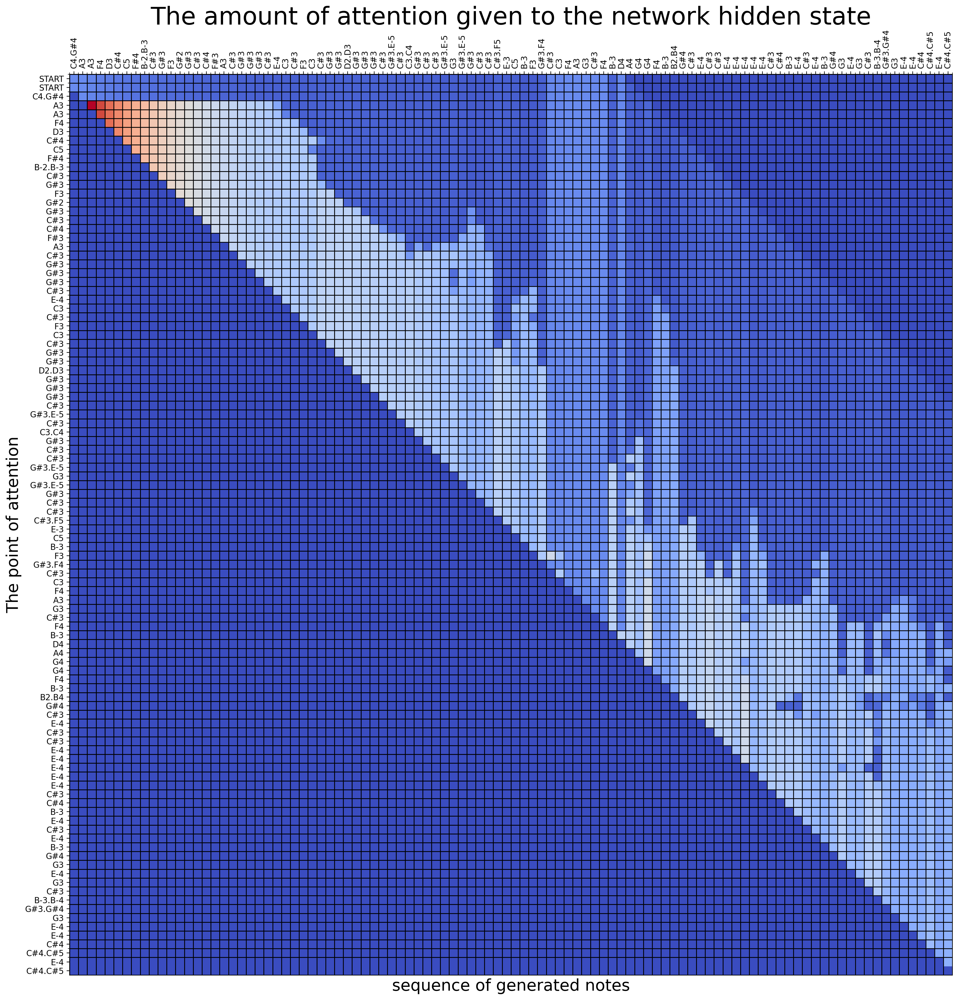

In [33]:
if use_attention:
    fig, ax = plt.subplots(figsize=(20,20))
    im = ax.imshow(att_matrix[(seq_len-2):,], cmap='coolwarm', interpolation='nearest')    

    # Minor ticks
    ax.set_xticks(np.arange(-.5, len(prediction_output)- seq_len, 1), minor=True);
    ax.set_yticks(np.arange(-.5, len(prediction_output)- seq_len, 1), minor=True);

    # Gridlines based on minor ticks
    ax.grid(which='minor', color='black', linestyle='-', linewidth=1)    
    
    # We want to show all ticks...
    ax.set_xticks(np.arange(len(prediction_output) - seq_len))
    ax.set_yticks(np.arange(len(prediction_output)- seq_len+2))
    # ... and label them with the respective list entries
    ax.set_xticklabels([n[0] for n in prediction_output[(seq_len):]])
    ax.set_yticklabels([n[0] for n in prediction_output[(seq_len - 2):]])
    ax.xaxis.tick_top()    
    plt.setp(ax.get_xticklabels(), rotation=90, ha="left", va = "center", rotation_mode="anchor")
    plt.xlabel("sequence of generated notes",fontsize=20)
    plt.ylabel("The point of attention",fontsize=20)
    plt.title("The amount of attention given to the network hidden state",fontsize=30)
    plt.show()

-----------------------------------
# Let's compare the original performance with the new one.

---------------------------------------
## Let's listen originals

In [34]:
IPython.display.Audio("chpn-p7.wav") 

In [35]:
new_score = converter.parse(new_path).chordify()

-------------------------------
## Newly composed music

Finally, let's listen to the music we made with our model.

In [36]:
IPython.display.Audio("new_output3.wav") 

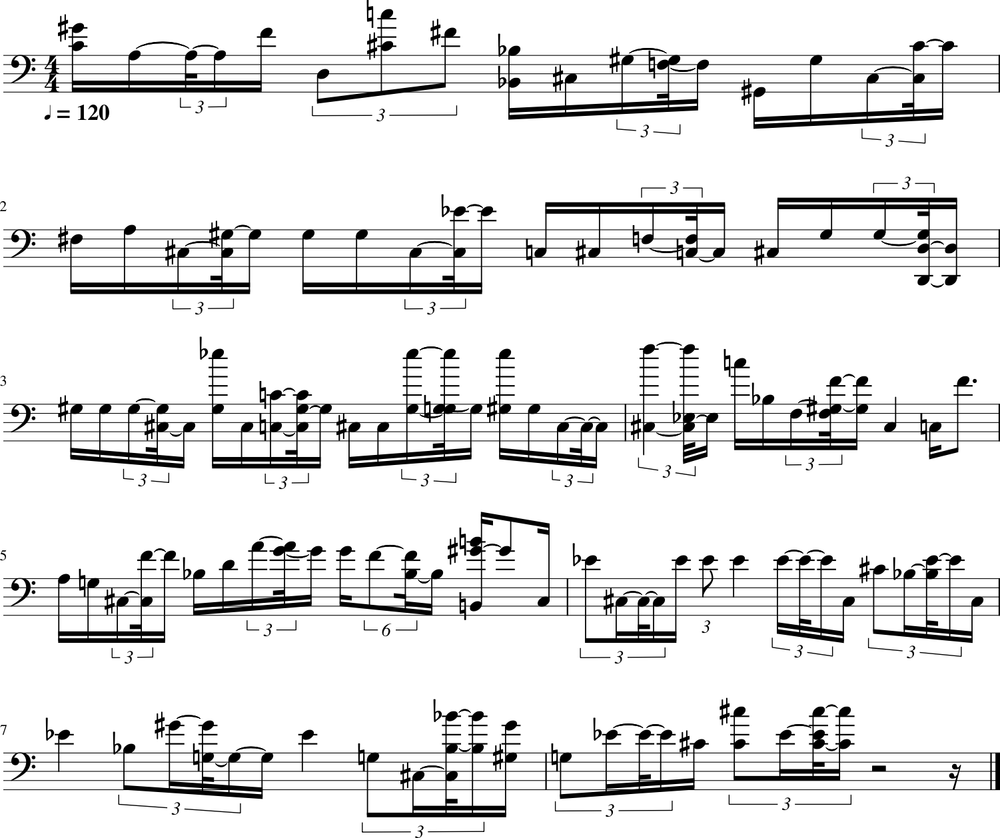

In [37]:
new_score.show()

<hr style="border: solid 3px blue;">